In [ ]:
!pip install duckduckgo_search

In [ ]:
!pip install fastbook
import fastbook
fastbook.setup_book()
from fastbook import *

In [ ]:
from fastai.vision.widgets import *
from duckduckgo_search import ddg_images
from fastcore.all import *

In [ ]:
from fastdownload import download_url
from fastai.vision.utils import download_images
from time import sleep

In [ ]:
def search_images(term, max_images = 30):
  # print(f"Searching for '{term}'")
  return L(ddg_images(term,max_results = max_images)).itemgot("image")

In [ ]:
crews = "Monkey D. Luffy", "Roronoa Zoro", "sanji", "tony tony chopper", "nami", "usopp","brook one piece", "Robin one piece", "Franky one piece"
path = Path("onePiece")
if not path.exists():
  path.mkdir()
for crew in crews:
  dest = (path/crew)
  dest.mkdir(exist_ok = True)
  download_images(dest,urls = search_images(f"{crew} pictures",max_images = 150))
  sleep(15)

In [ ]:
failed = verify_images( get_image_files(path) )
failed.map(Path.unlink)

(#39) [None,None,None,None,None,None,None,None,None,None...]

In [ ]:
dl = DataBlock(
    blocks = (ImageBlock, CategoryBlock),
    get_items = get_image_files,
    splitter = RandomSplitter(valid_pct = 0.2, seed = 67),
    get_y = parent_label,
    item_tfms = RandomResizedCrop(128, min_scale=0.3)
).dataloaders(path,bs =32)


In [ ]:
learn = vision_learner(dl,resnet18,metrics = error_rate)
learn.fine_tune(4)

epoch,train_loss,valid_loss,error_rate,time
0,1.865536,0.756508,0.239601,03:53


/usr/local/lib/python3.8/dist-packages/PIL/Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/PIL/Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/PIL/Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/PIL/Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


epoch,train_loss,valid_loss,error_rate,time
0,0.894547,0.514336,0.163062,05:06
1,0.627408,0.332068,0.101498,05:08
2,0.415007,0.251114,0.079867,05:08


/usr/local/lib/python3.8/dist-packages/PIL/Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/PIL/Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/PIL/Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/PIL/Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/PIL/Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/PIL/Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should b

epoch,train_loss,valid_loss,error_rate,time
0,0.894547,0.514336,0.163062,05:06
1,0.627408,0.332068,0.101498,05:08
2,0.415007,0.251114,0.079867,05:08
3,0.348676,0.224397,0.069884,05:00


/usr/local/lib/python3.8/dist-packages/PIL/Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/PIL/Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/PIL/Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


/usr/local/lib/python3.8/dist-packages/PIL/Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


/usr/local/lib/python3.8/dist-packages/PIL/Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


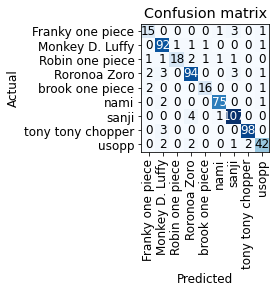

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

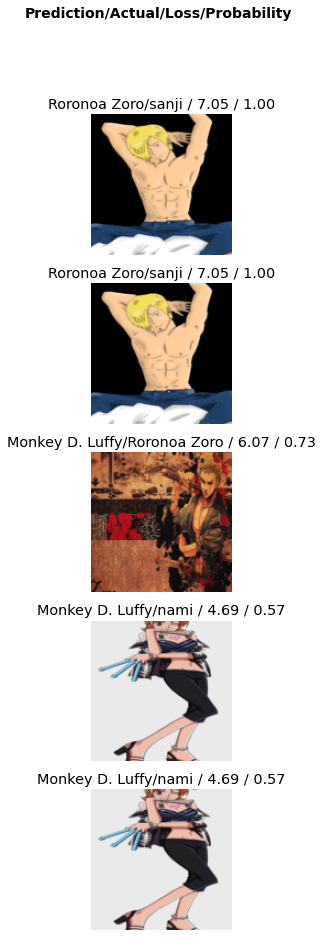

In [ ]:
interp.plot_top_losses(5,nrows=5)

In [ ]:
cleaner = ImageClassifierCleaner(learn)
cleaner

/usr/local/lib/python3.8/dist-packages/PIL/Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/PIL/Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


/usr/local/lib/python3.8/dist-packages/PIL/Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


In [ ]:
for idx in cleaner.delete():
  cleaner.fns[idx].unlink()
  print("hi")

hi


In [ ]:
learn.export()